In [10]:
# Cell 1: Install necessary packages
!pip install ultralytics easyocr opencv-python numpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.8/993.8 kB 15.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 59.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 45.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 32.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 37.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 74.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4

In [11]:
# Cell 2: Import Libraries
import cv2
import numpy as np
import easyocr
from ultralytics import YOLO
import matplotlib.pyplot as plt

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [12]:
# Cell 3: Initialize Models
# Load YOLOv8 model (you can replace 'yolov8n.pt' with your custom model if available)
yolo_model = YOLO('yolov8n.pt')

# Initialize EasyOCR
ocr_reader = easyocr.Reader(['en'], gpu=False)

100%|██████████| 6.25M/6.25M [00:00<00:00, 75.9MB/s]


Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

In [13]:
# Cell 4: Helper function to display frames inside notebook
def show_image(img, title="Output"):
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(12, 8))
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.title(title)
    plt.show()


0: 384x640 1 car, 284.8ms
Speed: 6.7ms preprocess, 284.8ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


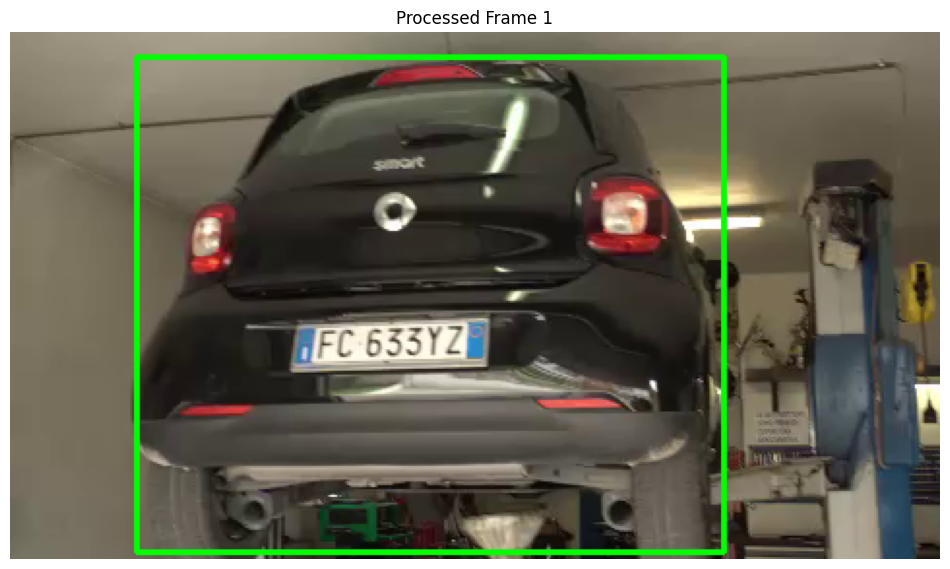


0: 384x640 1 car, 266.2ms
Speed: 3.4ms preprocess, 266.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


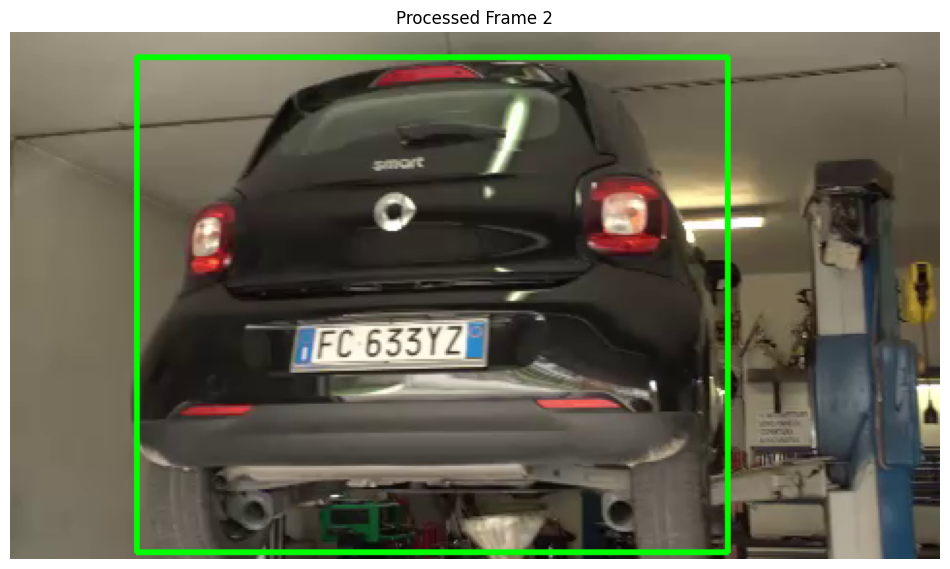


0: 384x640 1 car, 386.4ms
Speed: 3.4ms preprocess, 386.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Frame 3: OCR Detected Text: FC 633Y2_


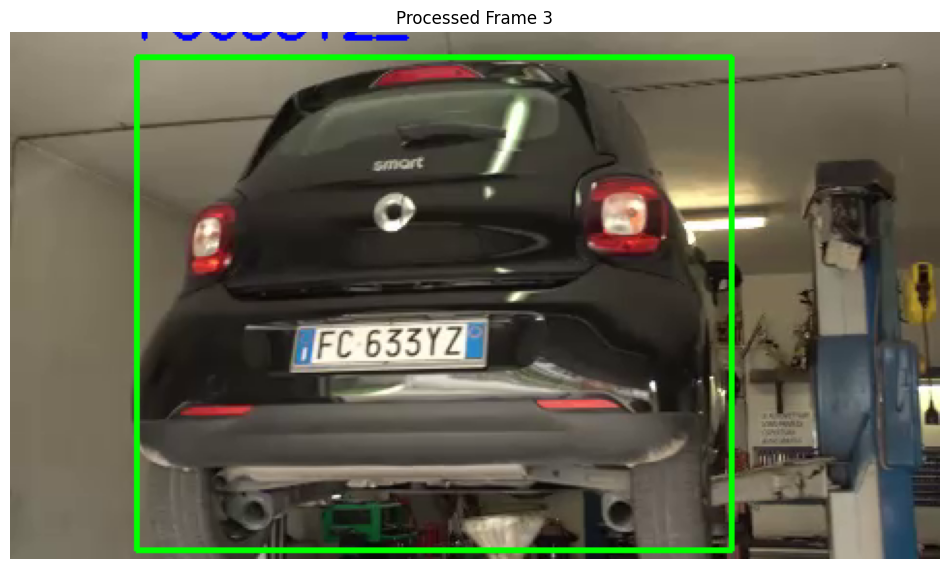


0: 384x640 1 car, 230.1ms
Speed: 3.4ms preprocess, 230.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)
Frame 4: OCR Detected Text: FC 633YZ


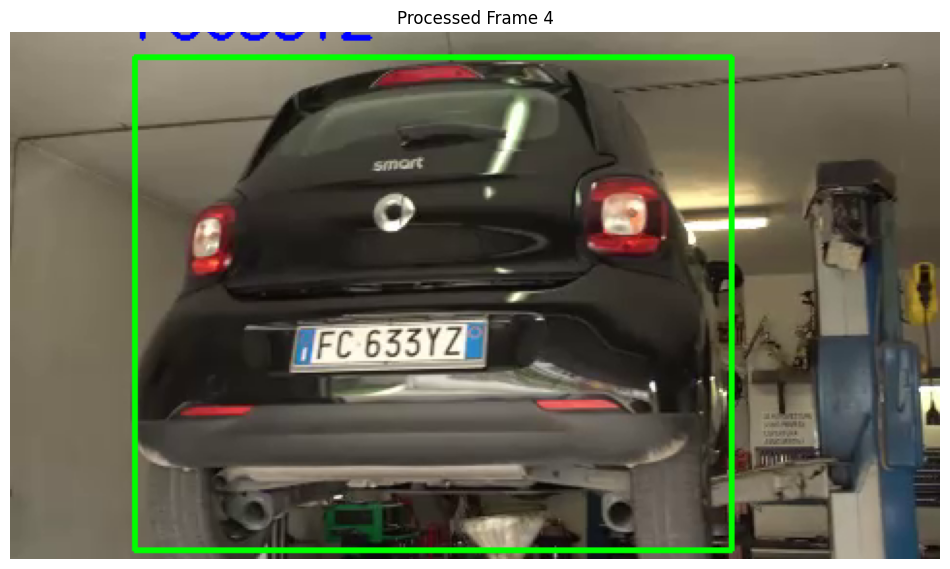


0: 384x640 1 car, 190.1ms
Speed: 3.4ms preprocess, 190.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Frame 5: OCR Detected Text: FC 633Y2


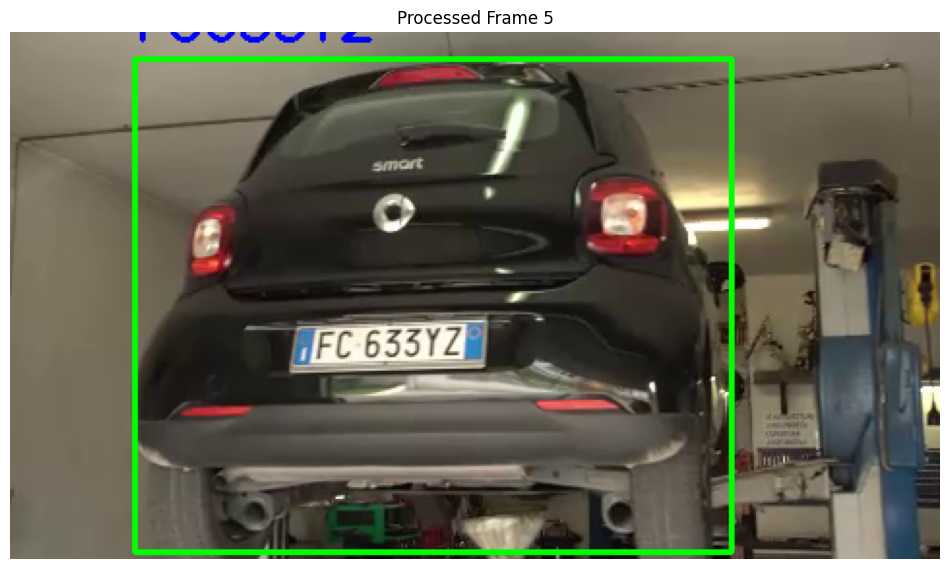


Detected Number Plates from all frames:
Frame 1: No plate detected
Frame 2: No plate detected
Frame 3: FC 633Y2_
Frame 4: FC 633YZ
Frame 5: FC 633Y2


In [18]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"1.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")

In [20]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (3).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0       CA455822
1        DS196EY
2        41K1006
3        FC633YZ
4       CB0600CA
5       06EFK521
6       06CUE710
7     MH49CL5498
8         HKA253
9      T22EA/116
10     23BH7974F
11    MH49CD2861
12    MH31FE0313
13    MH27BE0580
14    MH31FR5743
15    MH31FU6767
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH31FE0313', 'MH49CL5498', '06CUE710', 'MH31FR5743', '06EFK521', '23BH7974F', 'MH27BE0580', 'CA455822', 'FC633YZ', 'MH31FU6767', 'CB0600CA', '41K1006', 'HKA253', 'MH49CD2861', 'DS196EY', 'T22EA/116'}

Normalized Detected Plates:
{'FC633Y2', 'NOPLATEDETECTED', 'FC633YZ', 'FC633Y2_'}

Authorized Vehicle



0: 384x640 1 bus, 284.4ms
Speed: 4.5ms preprocess, 284.4ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)
Frame 1: OCR Detected Text: HKA
Frame 1: OCR Detected Text: 253


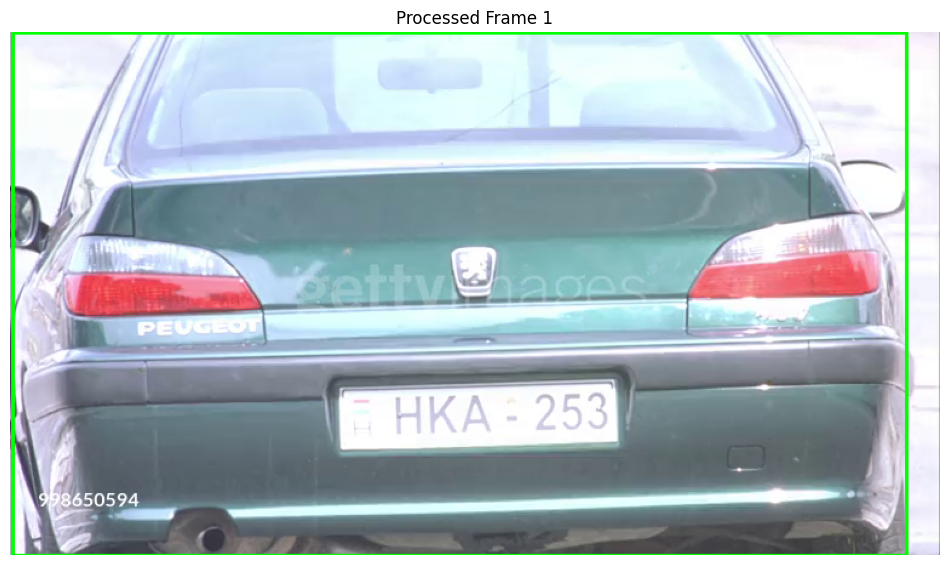


0: 384x640 1 bus, 206.6ms
Speed: 3.9ms preprocess, 206.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Frame 2: OCR Detected Text: bettv
Frame 2: OCR Detected Text: HKA
Frame 2: OCR Detected Text: 253


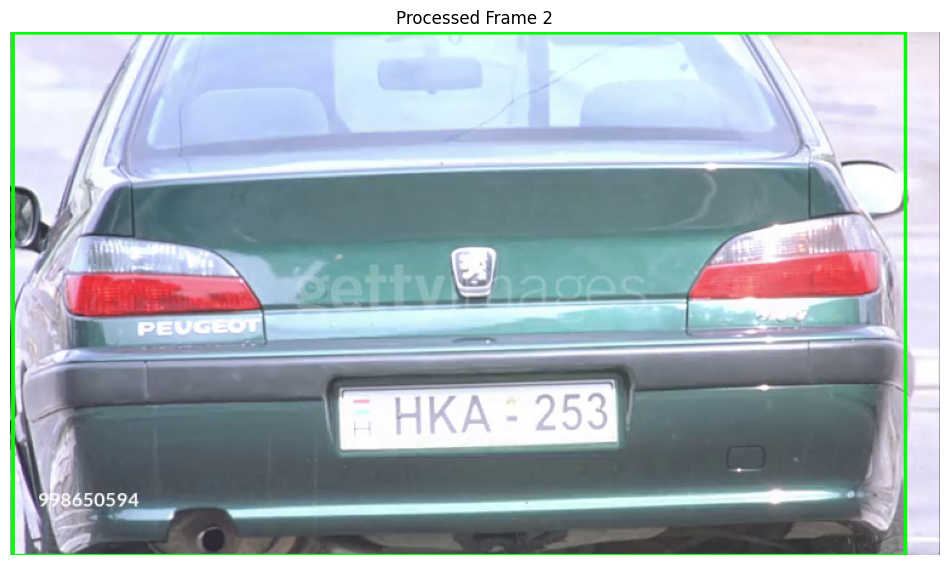


0: 384x640 1 bus, 188.3ms
Speed: 4.1ms preprocess, 188.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Frame 3: OCR Detected Text: HKA
Frame 3: OCR Detected Text: 253
Frame 3: OCR Detected Text: 998650594


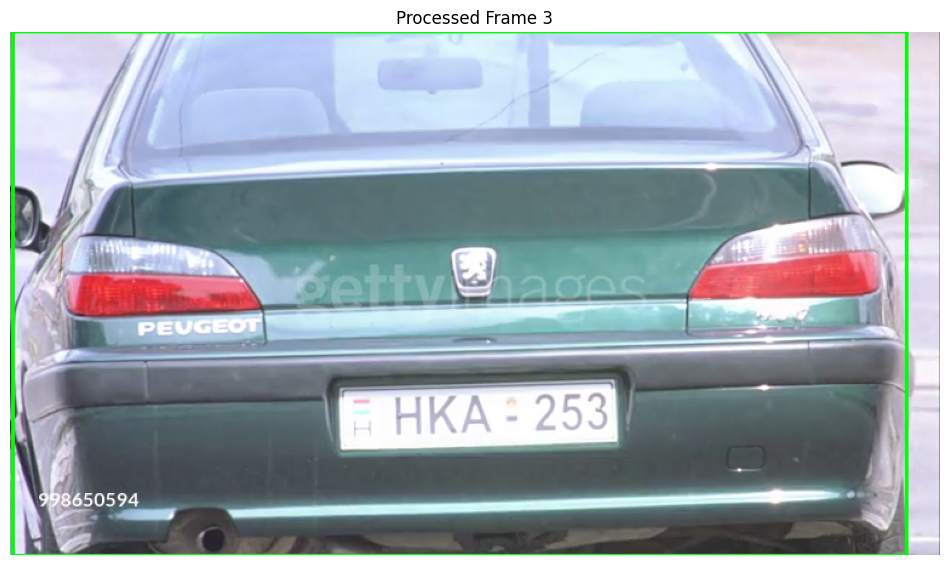


0: 384x640 1 car, 1 bus, 247.4ms
Speed: 3.7ms preprocess, 247.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Frame 4: OCR Detected Text: HKA
Frame 4: OCR Detected Text: 998650594
Frame 4: OCR Detected Text: HKA - 253
Frame 4: OCR Detected Text: 998650594


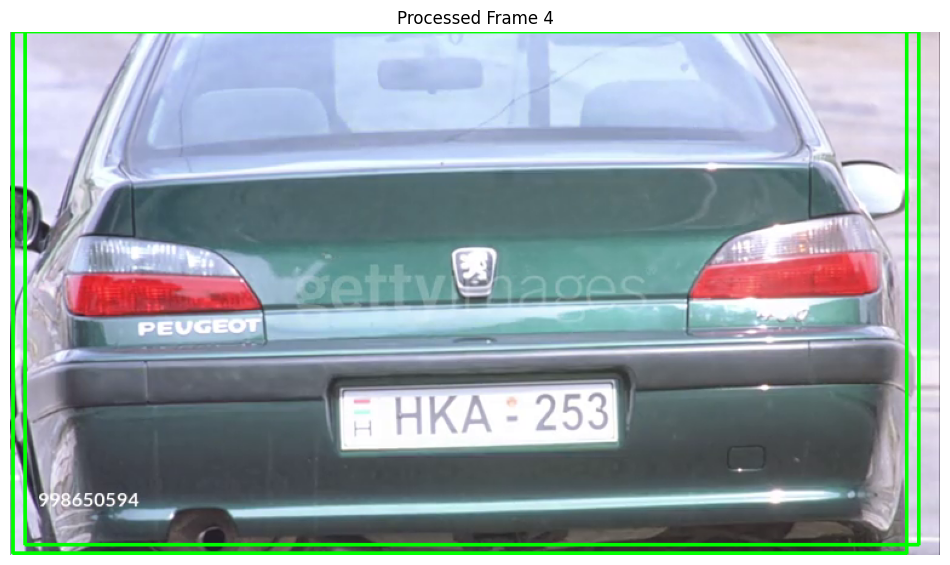


0: 384x640 1 bus, 200.7ms
Speed: 3.9ms preprocess, 200.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
Frame 5: OCR Detected Text: HKA
Frame 5: OCR Detected Text: 253
Frame 5: OCR Detected Text: 998650594


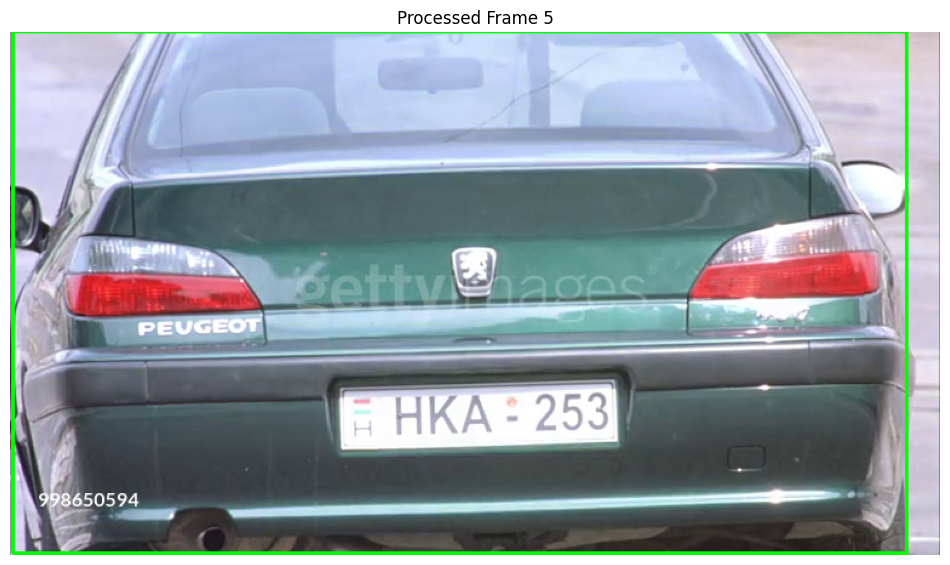


Detected Number Plates from all frames:
Frame 1: HKA253
Frame 2: bettvHKA253
Frame 3: HKA253998650594
Frame 4: HKA998650594HKA - 253998650594
Frame 5: HKA253998650594


In [ ]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"gettyimages-998650594-640_adpp.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")


In [ ]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (1).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")


License Plate Column from Excel:
0      CA455822
1       DS196EY
2       41K1006
3       FC633YZ
4      CB0600CA
5      06EFK521
6      06CUE710
7    MH49CL5498
8        HKA253
9     T22EA/116
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH49CL5498', 'HKA253', '06CUE710', 'CA455822', 'T22EA/116', 'DS196EY', 'FC633YZ', '06EFK521', 'CB0600CA', '41K1006'}

Normalized Detected Plates:
{'NOPLATEDETECTED', 'C4558', 'CA455822'}

Authorized Vehicle



0: 384x640 1 person, 1 car, 1 truck, 1 traffic light, 153.5ms
Speed: 5.0ms preprocess, 153.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Frame 1: OCR Detected Text: DS 1 96EY


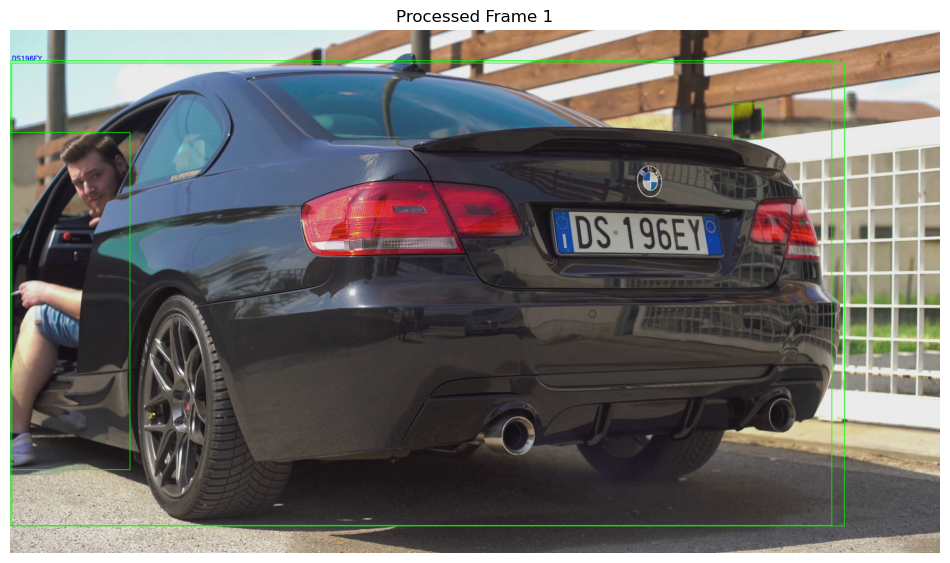


0: 384x640 1 person, 1 car, 1 truck, 134.4ms
Speed: 7.8ms preprocess, 134.4ms inference, 21.8ms postprocess per image at shape (1, 3, 384, 640)
Frame 2: OCR Detected Text: DS 196EY


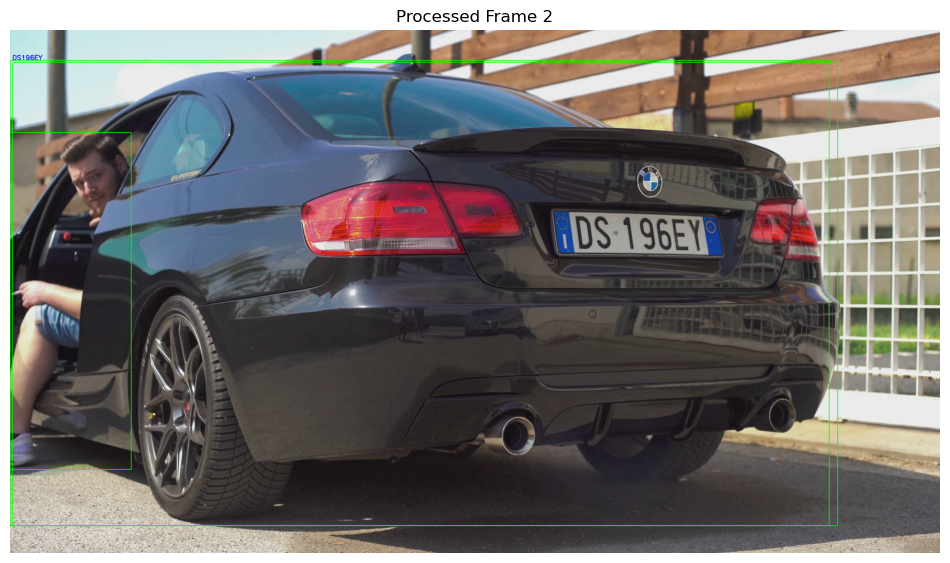


0: 384x640 1 person, 1 car, 391.7ms
Speed: 3.5ms preprocess, 391.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


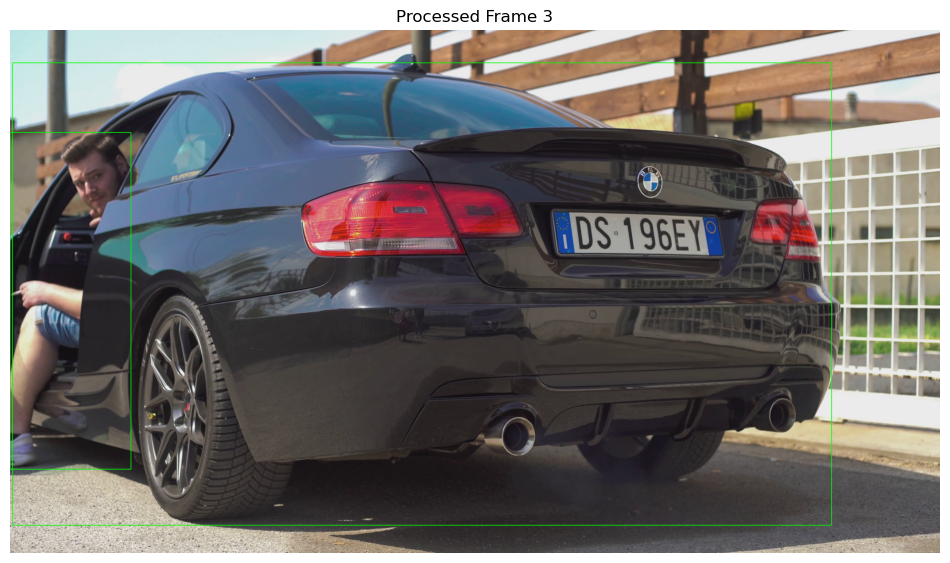


0: 384x640 1 person, 1 car, 1 truck, 88.4ms
Speed: 7.9ms preprocess, 88.4ms inference, 13.3ms postprocess per image at shape (1, 3, 384, 640)
Frame 4: OCR Detected Text: DS 196EY


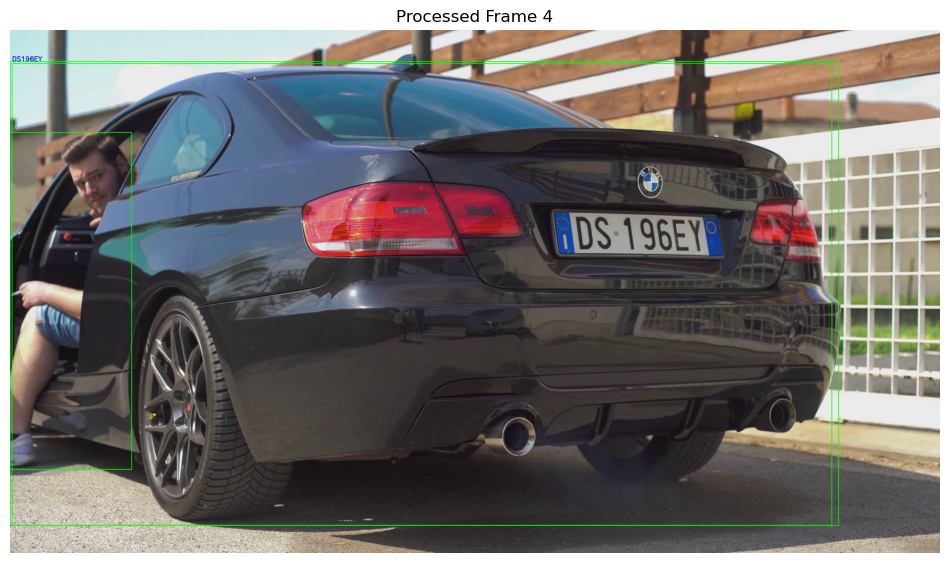


0: 384x640 1 person, 1 car, 325.7ms
Speed: 3.4ms preprocess, 325.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


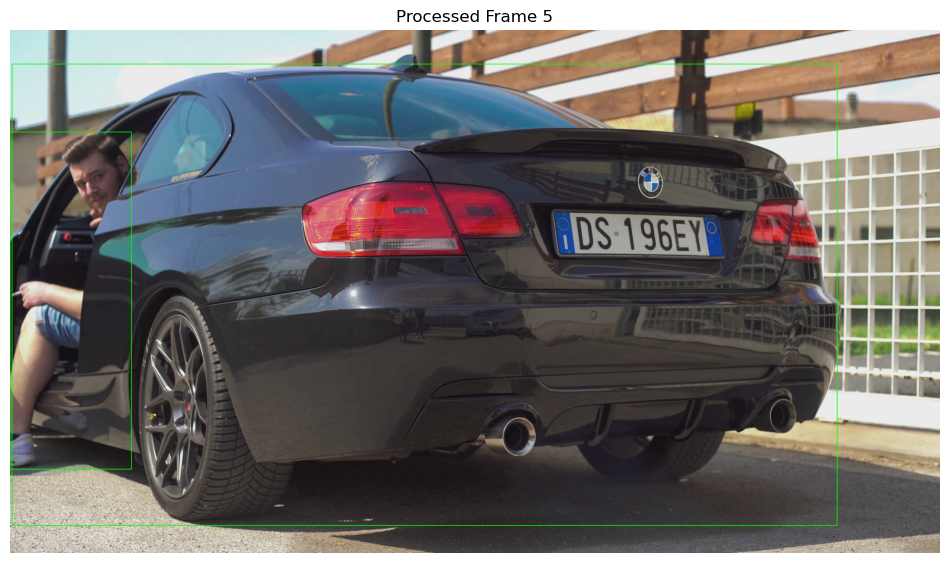


Detected Number Plates from all frames:
Frame 1: DS 1 96EY
Frame 2: DS 196EY
Frame 3: No plate detected
Frame 4: DS 196EY
Frame 5: No plate detected


In [ ]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"C:\Users\HP\Downloads\archive\images\video3.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")


In [ ]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate.xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0    CA455-822
1      DS196EY
2      41K1006
3      FC633YZ
4     CB0600CA
5     06EFK521
6     06CUE710
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'DS196EY', '41K1006', 'CA455-822', '06CUE710', '06EFK521', 'CB0600CA', 'FC633YZ'}

Normalized Detected Plates:
{'DS196EY', 'NOPLATEDETECTED'}

Authorized Vehicle



0: 384x640 5 cars, 304.4ms
Speed: 6.6ms preprocess, 304.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Frame 1: OCR Detected Text: C455 8


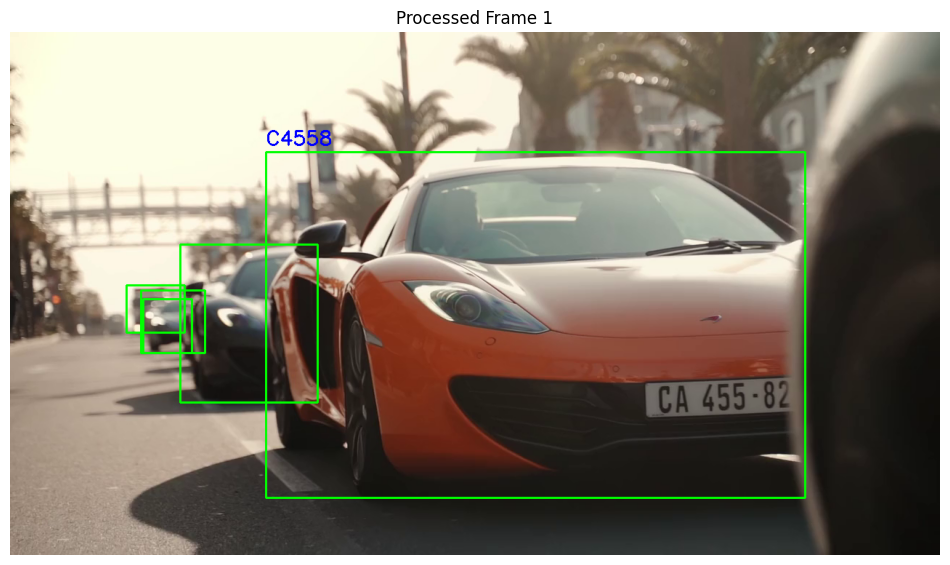


0: 384x640 5 cars, 189.0ms
Speed: 3.3ms preprocess, 189.0ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


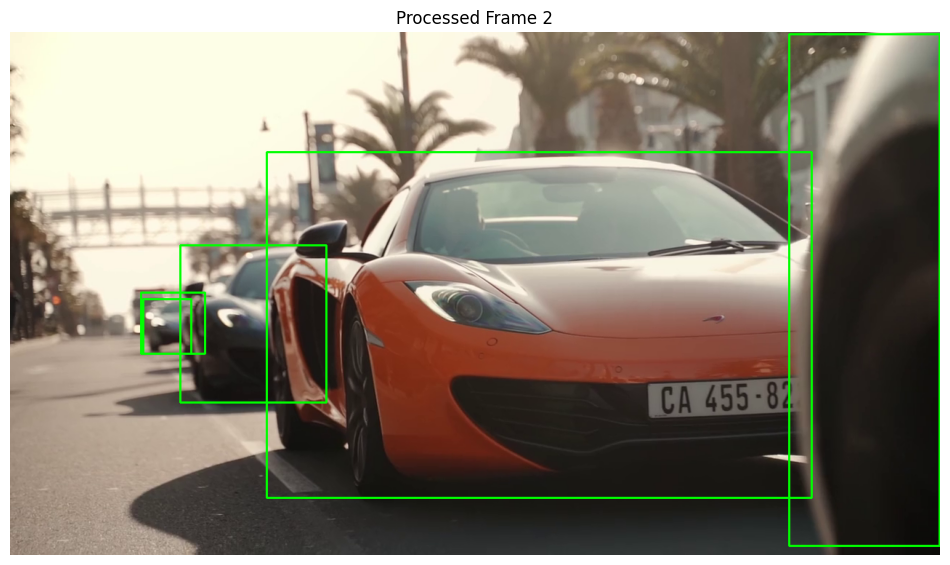


0: 384x640 6 cars, 186.2ms
Speed: 3.6ms preprocess, 186.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


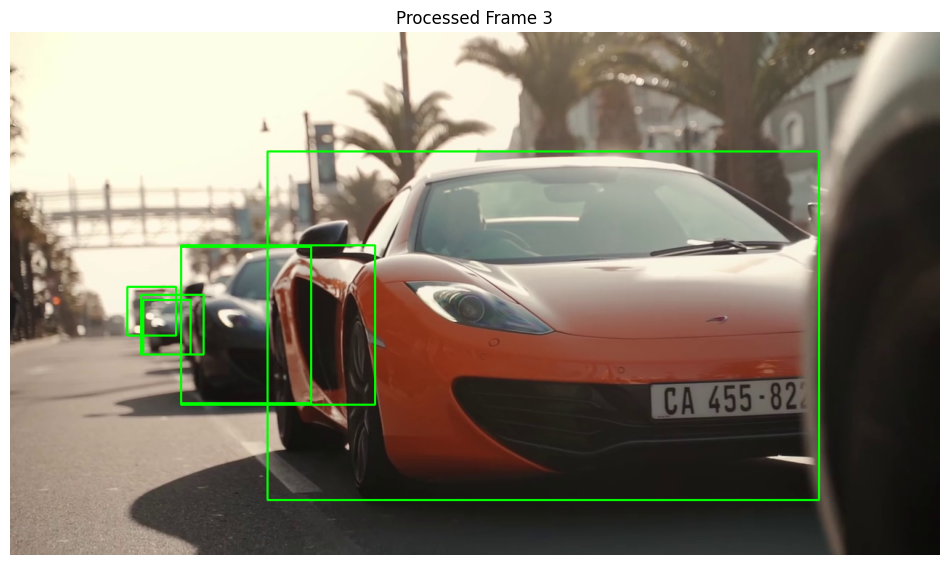


0: 384x640 7 cars, 195.4ms
Speed: 3.5ms preprocess, 195.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


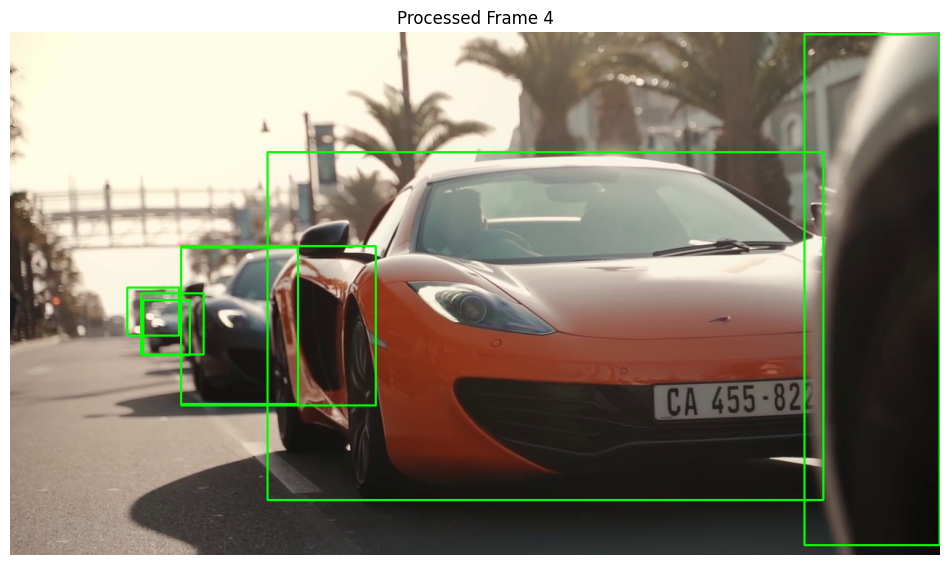


0: 384x640 6 cars, 260.7ms
Speed: 5.0ms preprocess, 260.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Frame 5: OCR Detected Text: CA 455 822


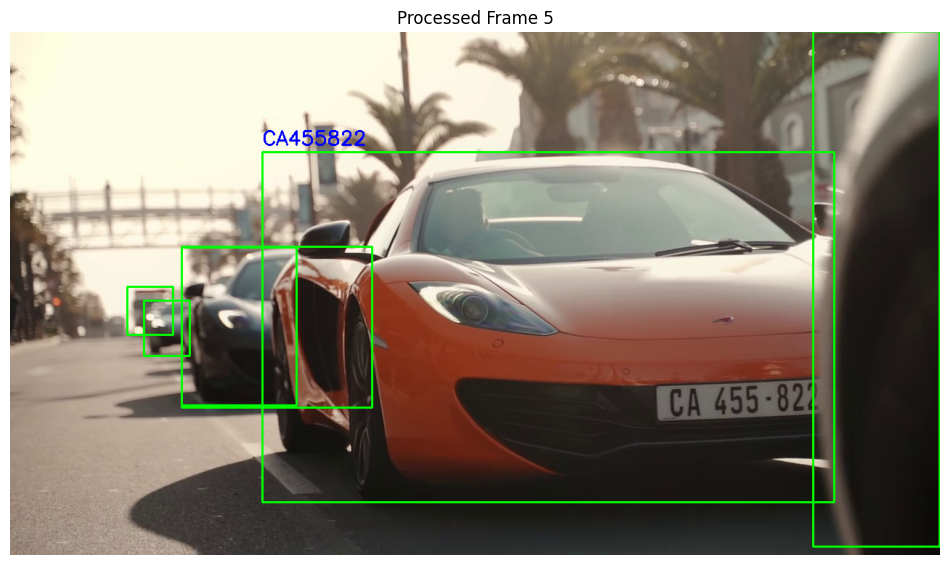


Detected Number Plates from all frames:
Frame 1: C455 8
Frame 2: No plate detected
Frame 3: No plate detected
Frame 4: No plate detected
Frame 5: CA 455 822


In [ ]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"4.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")

In [ ]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (1).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0      CA455822
1       DS196EY
2       41K1006
3       FC633YZ
4      CB0600CA
5      06EFK521
6      06CUE710
7    MH49CL5498
8        HKA253
9     T22EA/116
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH49CL5498', 'HKA253', '06CUE710', 'CA455822', 'T22EA/116', 'DS196EY', 'FC633YZ', '06EFK521', 'CB0600CA', '41K1006'}

Normalized Detected Plates:
{'NOPLATEDETECTED', 'C4558', 'CA455822'}

Authorized Vehicle



0: 640x384 1 car, 293.0ms
Speed: 5.1ms preprocess, 293.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 384)
Frame 1: OCR Detected Text: 06
Frame 1: OCR Detected Text: CUE
Frame 1: OCR Detected Text: 710


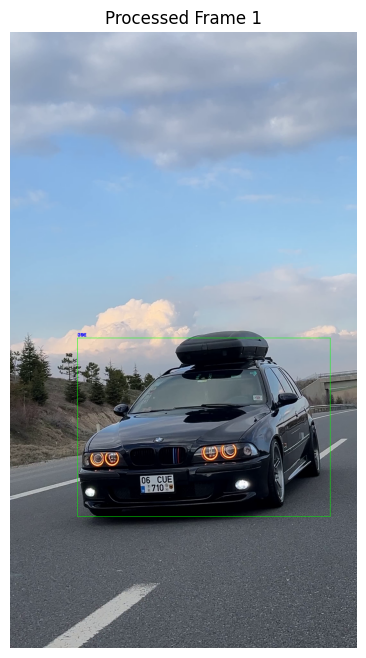


0: 640x384 1 car, 180.0ms
Speed: 5.2ms preprocess, 180.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)
Frame 2: OCR Detected Text: 0
Frame 2: OCR Detected Text: 06
Frame 2: OCR Detected Text: CUE
Frame 2: OCR Detected Text: 710


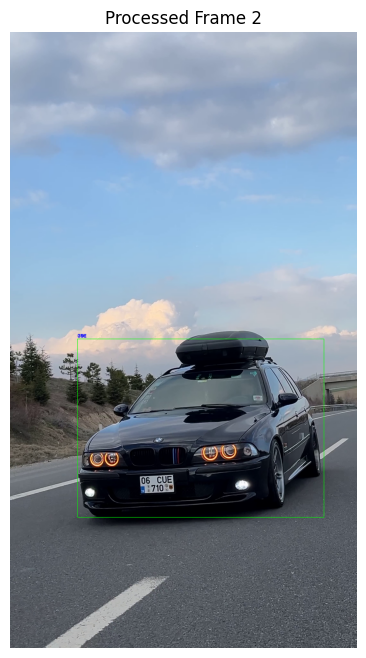


0: 640x384 1 car, 209.3ms
Speed: 4.9ms preprocess, 209.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Frame 3: OCR Detected Text: 0(
Frame 3: OCR Detected Text: 6
Frame 3: OCR Detected Text: CUE
Frame 3: OCR Detected Text: 710


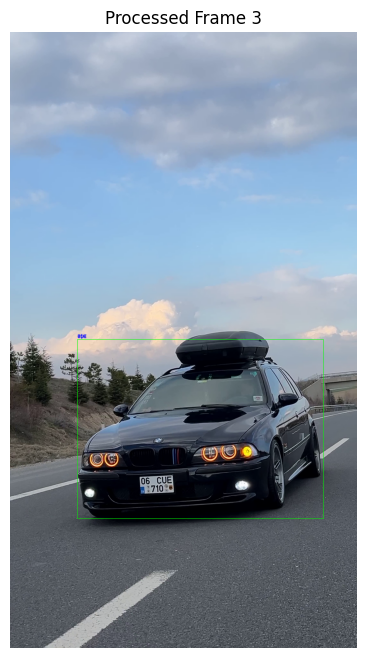


0: 640x384 1 car, 206.2ms
Speed: 12.0ms preprocess, 206.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)
Frame 4: OCR Detected Text: 0(
Frame 4: OCR Detected Text: 06
Frame 4: OCR Detected Text: CUE
Frame 4: OCR Detected Text: 710


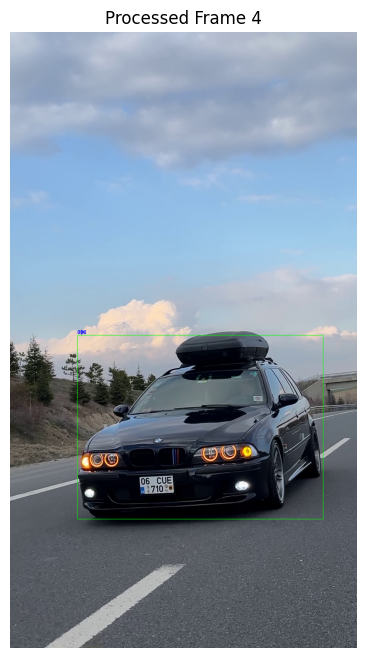


0: 640x384 1 car, 190.2ms
Speed: 9.7ms preprocess, 190.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)
Frame 5: OCR Detected Text: 0
Frame 5: OCR Detected Text: 06
Frame 5: OCR Detected Text: CUE
Frame 5: OCR Detected Text: 710


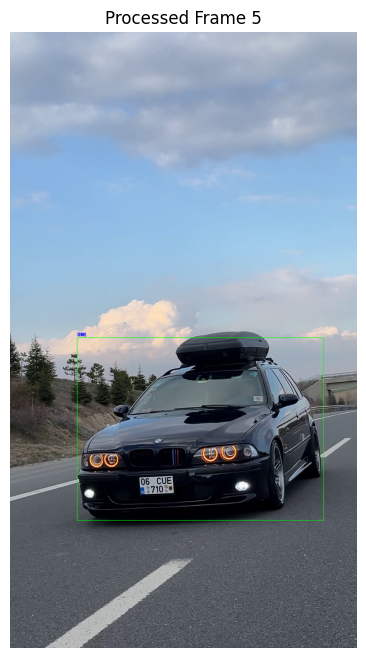


Detected Number Plates from all frames:
Frame 1: 06CUE710
Frame 2: 006CUE710
Frame 3: 0(6CUE710
Frame 4: 0(06CUE710
Frame 5: 006CUE710


In [ ]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"11939948_2160_3840_60fps.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")


In [ ]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (1).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0      CA455822
1       DS196EY
2       41K1006
3       FC633YZ
4      CB0600CA
5      06EFK521
6      06CUE710
7    MH49CL5498
8        HKA253
9     T22EA/116
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH49CL5498', 'HKA253', '06CUE710', 'CA455822', 'T22EA/116', 'DS196EY', 'FC633YZ', '06EFK521', 'CB0600CA', '41K1006'}

Normalized Detected Plates:
{'06CUE710', '0(6CUE710', '0(06CUE710', '006CUE710'}

Authorized Vehicle



0: 640x384 1 car, 158.8ms
Speed: 4.0ms preprocess, 158.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)


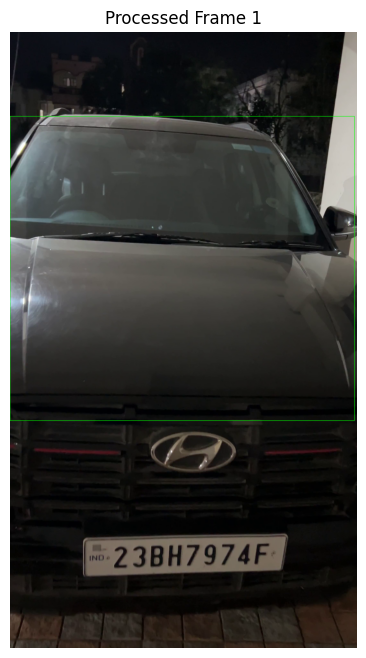


0: 640x384 2 cars, 196.2ms
Speed: 14.0ms preprocess, 196.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)
Frame 2: OCR Detected Text: INU


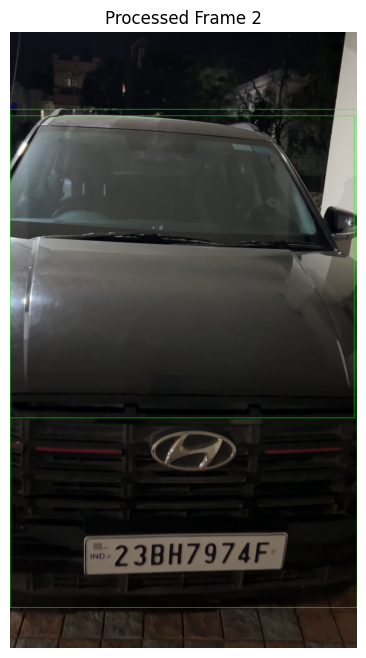


0: 640x384 2 cars, 182.6ms
Speed: 8.5ms preprocess, 182.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)
Frame 3: OCR Detected Text: 23BH7974F


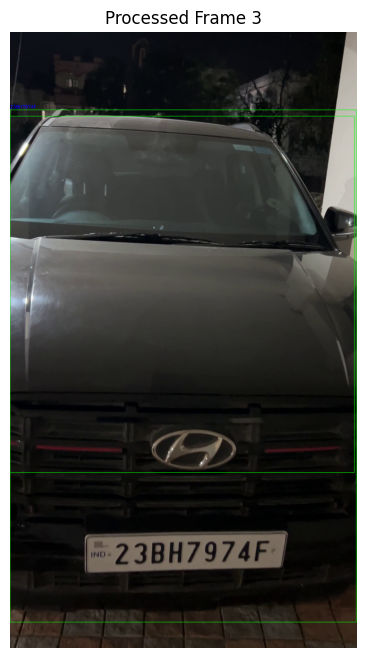


Detected Number Plates from all frames:
Frame 1: No plate detected
Frame 2: INU
Frame 3: 23BH7974F


In [42]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"IMG_3384.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 3:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")


In [46]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (3).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0       CA455822
1        DS196EY
2        41K1006
3        FC633YZ
4       CB0600CA
5       06EFK521
6       06CUE710
7     MH49CL5498
8         HKA253
9      T22EA/116
10     23BH7974F
11    MH49CD2861
12    MH31FE0313
13    MH27BE0580
14    MH31FR5743
15    MH31FU6767
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH31FU6767', 'MH49CL5498', 'HKA253', '23BH7974F', 'MH31FE0313', 'MH31FR5743', 'MH27BE0580', '06CUE710', 'CA455822', 'T22EA/116', 'DS196EY', 'FC633YZ', '06EFK521', 'MH49CD2861', 'CB0600CA', '41K1006'}

Normalized Detected Plates:
{'619370586075MH31FE0313', '619370506075MH31FE0313', 'MH31FE0313'}

Authorized Vehicle



0: 640x384 2 cars, 1 cell phone, 175.0ms
Speed: 5.3ms preprocess, 175.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 384)
Frame 1: OCR Detected Text: IND
Frame 1: OCR Detected Text: MH31FU6767
Frame 1: OCR Detected Text: 6
Frame 1: OCR Detected Text: IND
Frame 1: OCR Detected Text: MH31FU6767


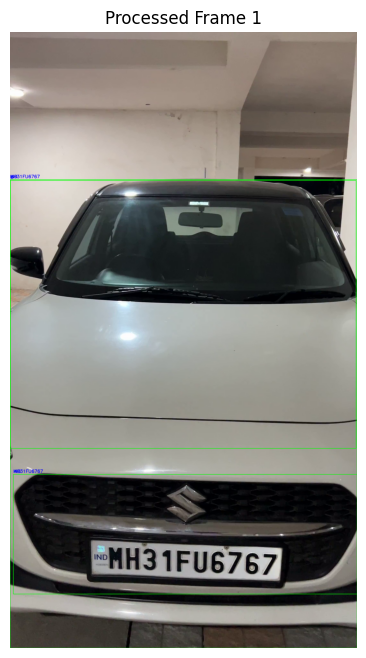


0: 640x384 2 cars, 1 cell phone, 204.1ms
Speed: 7.4ms preprocess, 204.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)
Frame 2: OCR Detected Text: IND
Frame 2: OCR Detected Text: IND
Frame 2: OCR Detected Text: MH3 1FU6767


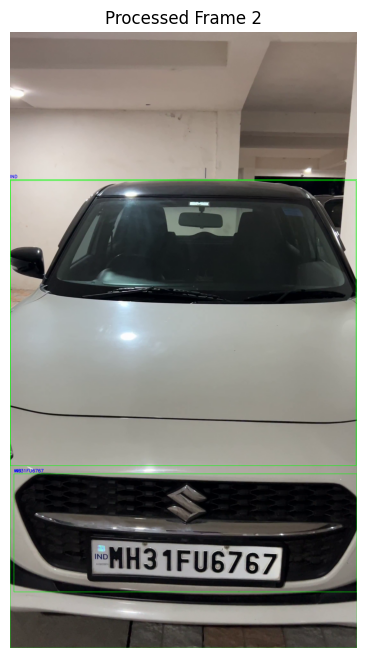


0: 640x384 2 cars, 1 cell phone, 188.4ms
Speed: 8.2ms preprocess, 188.4ms inference, 58.4ms postprocess per image at shape (1, 3, 640, 384)
Frame 3: OCR Detected Text: IND
Frame 3: OCR Detected Text: MH3 1FU6767
Frame 3: OCR Detected Text: 6
Frame 3: OCR Detected Text: IND


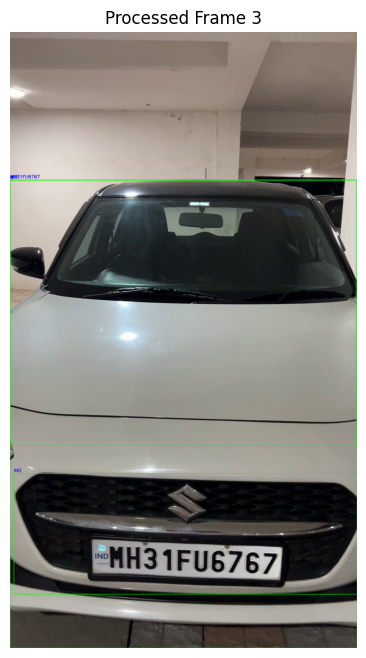


Detected Number Plates from all frames:
Frame 1: INDMH31FU67676INDMH31FU6767
Frame 2: INDINDMH3 1FU6767
Frame 3: INDMH3 1FU67676IND


In [43]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"IMG_3380.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 3:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")

In [47]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (3).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0       CA455822
1        DS196EY
2        41K1006
3        FC633YZ
4       CB0600CA
5       06EFK521
6       06CUE710
7     MH49CL5498
8         HKA253
9      T22EA/116
10     23BH7974F
11    MH49CD2861
12    MH31FE0313
13    MH27BE0580
14    MH31FR5743
15    MH31FU6767
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH31FU6767', 'MH49CL5498', 'HKA253', '23BH7974F', 'MH31FE0313', 'MH31FR5743', 'MH27BE0580', '06CUE710', 'CA455822', 'T22EA/116', 'DS196EY', 'FC633YZ', '06EFK521', 'MH49CD2861', 'CB0600CA', '41K1006'}

Normalized Detected Plates:
{'619370586075MH31FE0313', '619370506075MH31FE0313', 'MH31FE0313'}

Authorized Vehicle



0: 640x384 1 car, 178.5ms
Speed: 12.0ms preprocess, 178.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Frame 1: OCR Detected Text: MH 31
Frame 1: OCR Detected Text: FE 0313


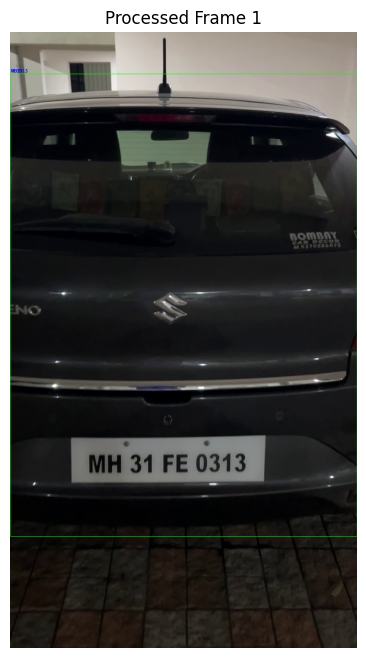


0: 640x384 1 car, 211.1ms
Speed: 6.0ms preprocess, 211.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)
Frame 2: OCR Detected Text: 619370506075
Frame 2: OCR Detected Text: MH 31
Frame 2: OCR Detected Text: FE 0313


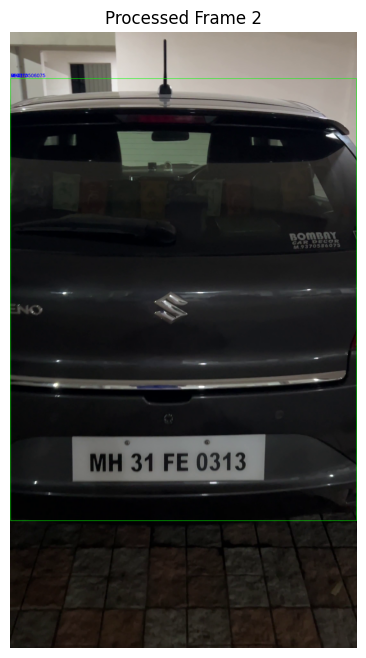


0: 640x384 1 car, 188.4ms
Speed: 12.1ms preprocess, 188.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)
Frame 3: OCR Detected Text: 619370586075
Frame 3: OCR Detected Text: MH 31
Frame 3: OCR Detected Text: FE 0313


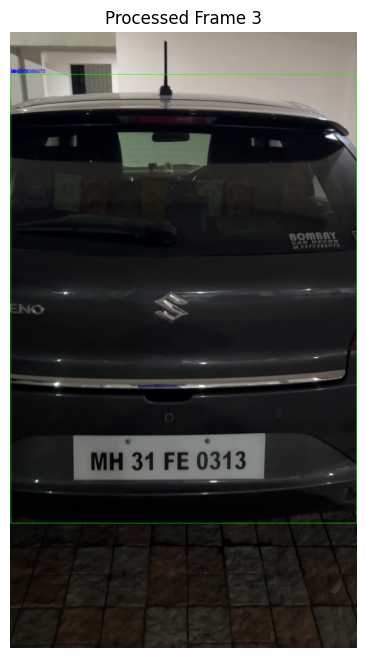


Detected Number Plates from all frames:
Frame 1: MH 31FE 0313
Frame 2: 619370506075MH 31FE 0313
Frame 3: 619370586075MH 31FE 0313


In [45]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"IMG_3382.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 3:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")

In [49]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (3).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0       CA455822
1        DS196EY
2        41K1006
3        FC633YZ
4       CB0600CA
5       06EFK521
6       06CUE710
7     MH49CL5498
8         HKA253
9      T22EA/116
10     23BH7974F
11    MH49CD2861
12    MH31FE0313
13    MH27BE0580
14    MH31FR5743
15    MH31FU6767
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH31FU6767', 'MH49CL5498', 'HKA253', '23BH7974F', 'MH31FE0313', 'MH31FR5743', 'MH27BE0580', '06CUE710', 'CA455822', 'T22EA/116', 'DS196EY', 'FC633YZ', '06EFK521', 'MH49CD2861', 'CB0600CA', '41K1006'}

Normalized Detected Plates:
{'619370586075MH31FE0313', '619370506075MH31FE0313', 'MH31FE0313'}

Authorized Vehicle



0: 640x384 1 bus, 331.5ms
Speed: 20.5ms preprocess, 331.5ms inference, 34.3ms postprocess per image at shape (1, 3, 640, 384)
Frame 1: OCR Detected Text: 9
Frame 1: OCR Detected Text: HH49Cd286 1


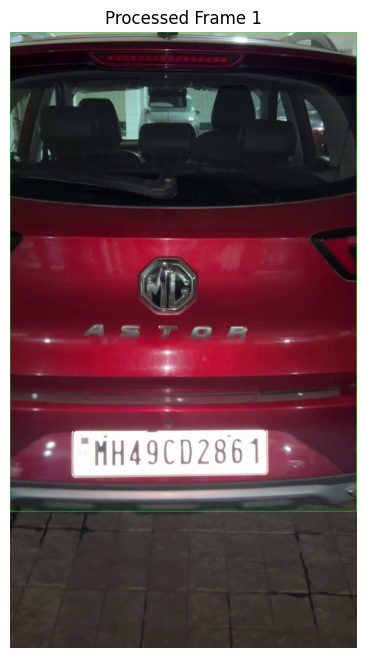


0: 640x384 1 bus, 279.1ms
Speed: 7.9ms preprocess, 279.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)


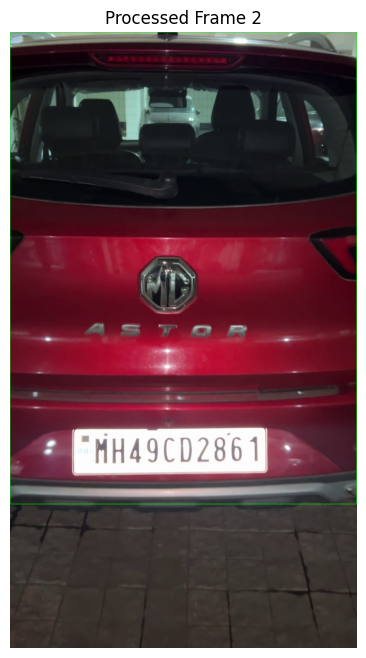


0: 640x384 1 bus, 1 train, 205.0ms
Speed: 4.8ms preprocess, 205.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)
Frame 3: OCR Detected Text: 0
Frame 3: OCR Detected Text: MH49cd286 1


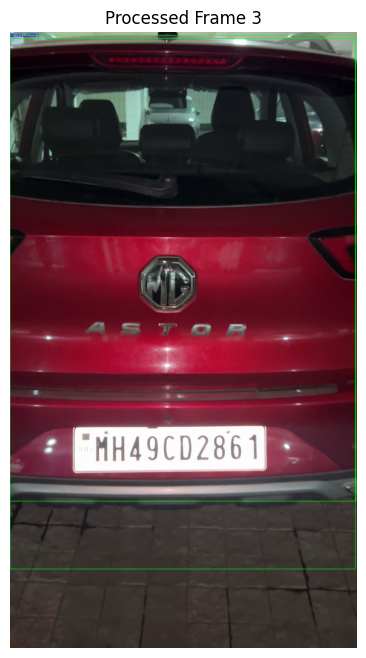


Detected Number Plates from all frames:
Frame 1: 9HH49Cd286 1
Frame 2: No plate detected
Frame 3: 0MH49cd286 1


In [14]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"IMG_3381.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 3:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")

In [17]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (3).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0       CA455822
1        DS196EY
2        41K1006
3        FC633YZ
4       CB0600CA
5       06EFK521
6       06CUE710
7     MH49CL5498
8         HKA253
9      T22EA/116
10     23BH7974F
11    MH49CD2861
12    MH31FE0313
13    MH27BE0580
14    MH31FR5743
15    MH31FU6767
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH31FE0313', 'MH49CL5498', '06CUE710', 'MH31FR5743', '06EFK521', '23BH7974F', 'MH27BE0580', 'CA455822', 'FC633YZ', 'MH31FU6767', 'CB0600CA', '41K1006', 'HKA253', 'MH49CD2861', 'DS196EY', 'T22EA/116'}

Normalized Detected Plates:
{'0MH49CD2861', 'NOPLATEDETECTED', '9HH49CD2861'}

Unauthorized Vehicle


In [ ]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (3).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

In [ ]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"IMG_3380.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 3:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")


0: 384x640 1 car, 281.7ms
Speed: 5.5ms preprocess, 281.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Frame 1: OCR Detected Text: T226EA/1161
Frame 1: OCR Detected Text: BOSCH Service
Frame 1: OCR Detected Text: AABDA
Frame 1: OCR Detected Text: (843) 239-29-25


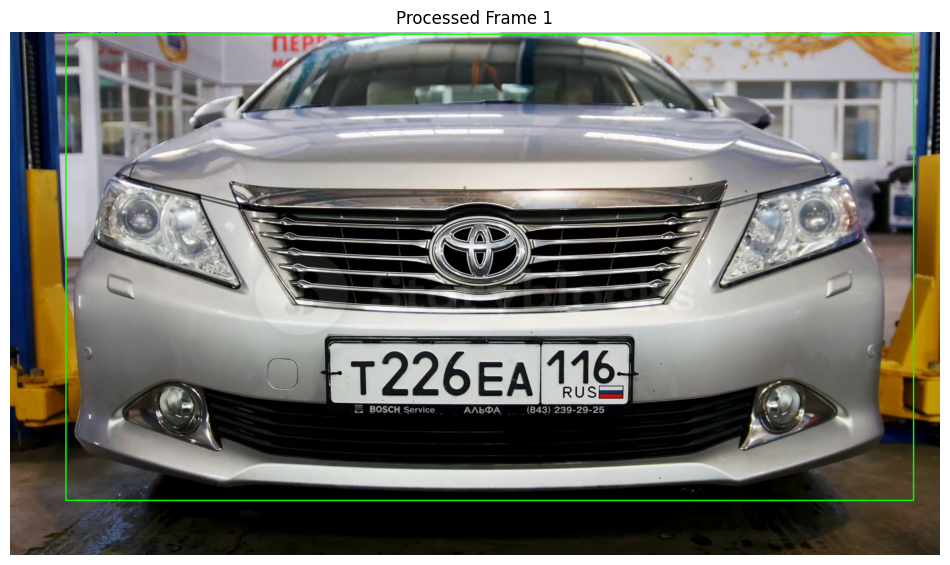


0: 384x640 1 car, 191.7ms
Speed: 8.9ms preprocess, 191.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)
Frame 2: OCR Detected Text: T226EA/146]
Frame 2: OCR Detected Text: BOSCH Service
Frame 2: OCR Detected Text: AABDA
Frame 2: OCR Detected Text: (843) 239-29-25


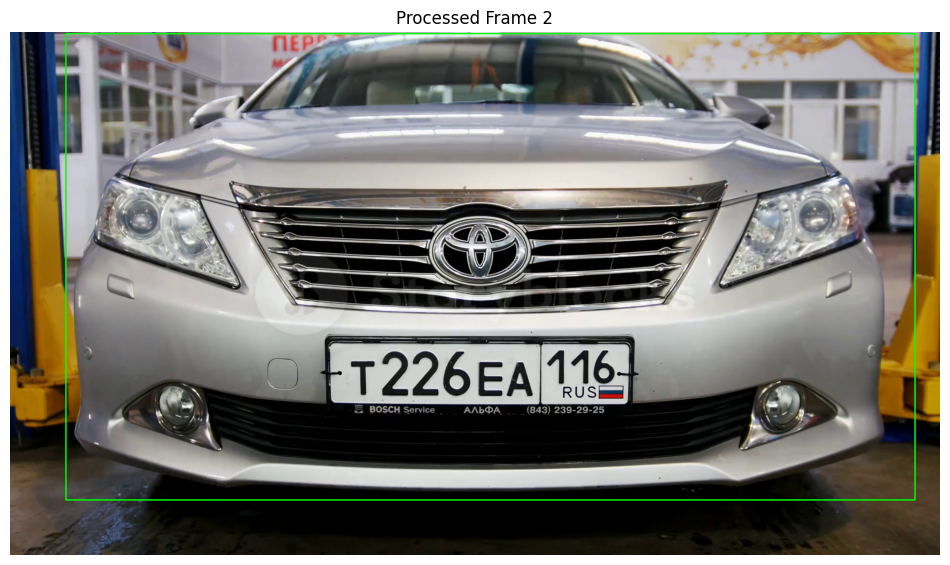


0: 384x640 1 car, 220.5ms
Speed: 5.6ms preprocess, 220.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)
Frame 3: OCR Detected Text: T226EA/116
Frame 3: OCR Detected Text: RUSE
Frame 3: OCR Detected Text: BOSCH Service
Frame 3: OCR Detected Text: AABDA
Frame 3: OCR Detected Text: (843) 239-29-25


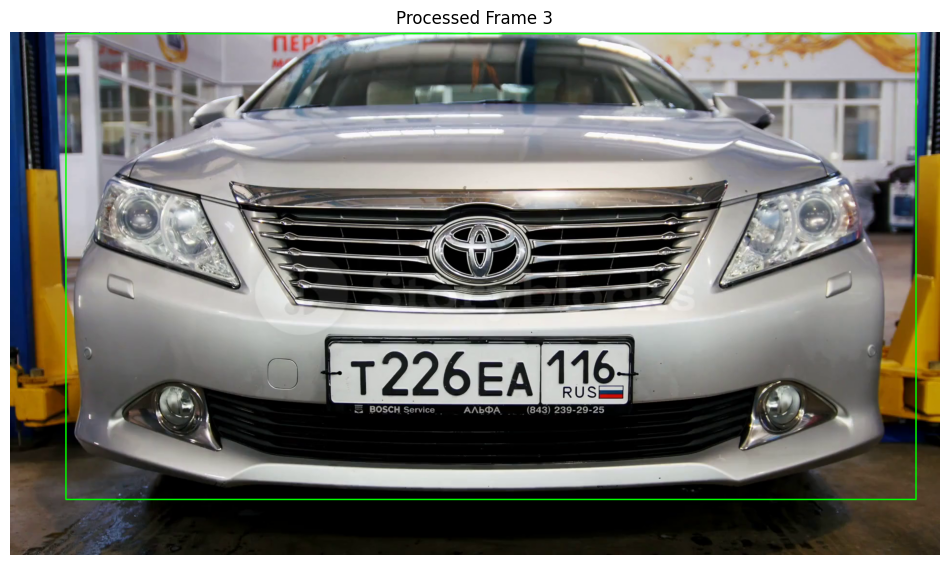


0: 384x640 1 car, 244.4ms
Speed: 4.8ms preprocess, 244.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
Frame 4: OCR Detected Text: T226EA/16
Frame 4: OCR Detected Text: RUSE
Frame 4: OCR Detected Text: BOSCH Service
Frame 4: OCR Detected Text: AABDA
Frame 4: OCR Detected Text: (843) 239-29-25


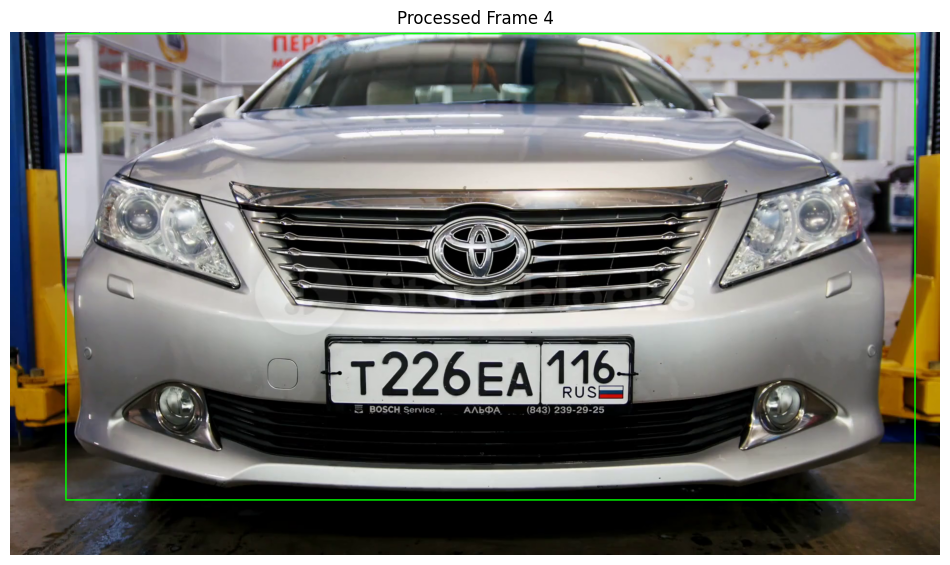


0: 384x640 1 car, 233.1ms
Speed: 5.2ms preprocess, 233.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
Frame 5: OCR Detected Text: MEP
Frame 5: OCR Detected Text: T226EA/116
Frame 5: OCR Detected Text: RUSE
Frame 5: OCR Detected Text: BOSCH Service
Frame 5: OCR Detected Text: AABDA
Frame 5: OCR Detected Text: (843) 239-29-25


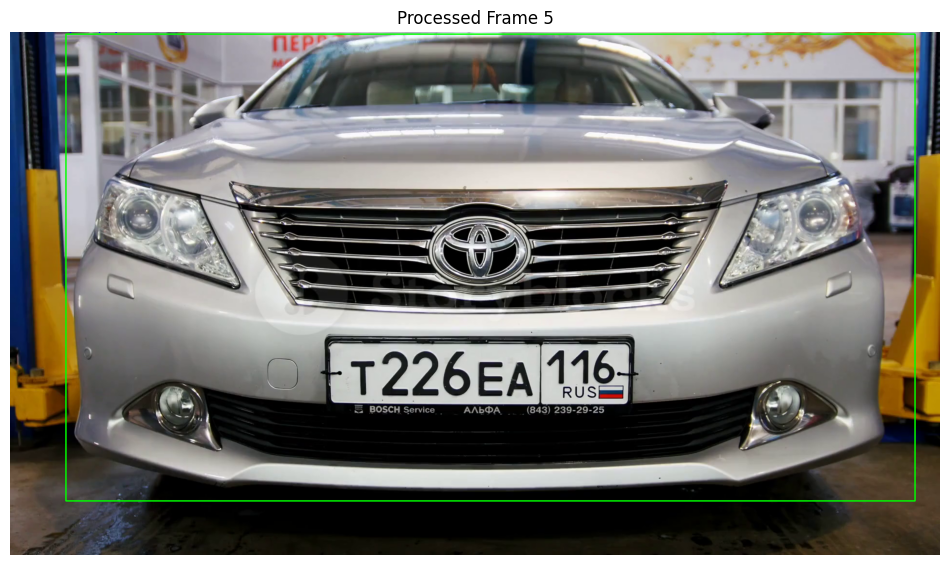


Detected Number Plates from all frames:
Frame 1: T226EA/1161BOSCH ServiceAABDA(843) 239-29-25
Frame 2: T226EA/146]BOSCH ServiceAABDA(843) 239-29-25
Frame 3: T226EA/116RUSEBOSCH ServiceAABDA(843) 239-29-25
Frame 4: T226EA/16RUSEBOSCH ServiceAABDA(843) 239-29-25
Frame 5: MEPT226EA/116RUSEBOSCH ServiceAABDA(843) 239-29-25


In [ ]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"kazan-russia-4-may-2017-toyota-camry-coming-to-car-service-SBV-314766590-preview.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")


In [ ]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (1).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0      CA455822
1       DS196EY
2       41K1006
3       FC633YZ
4      CB0600CA
5      06EFK521
6      06CUE710
7    MH49CL5498
8        HKA253
9     T22EA/116
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH49CL5498', 'HKA253', '06CUE710', 'CA455822', 'T22EA/116', 'DS196EY', 'FC633YZ', '06EFK521', 'CB0600CA', '41K1006'}

Normalized Detected Plates:
{'06CUE710', '0(6CUE710', '0(06CUE710', '006CUE710'}

Authorized Vehicle



0: 640x384 2 cars, 2 trucks, 147.9ms
Speed: 4.0ms preprocess, 147.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 384)
Frame 1: OCR Detected Text: MHLICL5498
Frame 1: OCR Detected Text: MHLICL5498


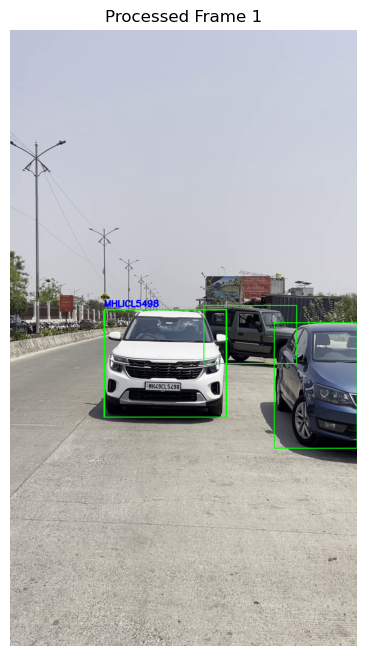


0: 640x384 2 cars, 2 trucks, 70.7ms
Speed: 5.0ms preprocess, 70.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 384)
Frame 2: OCR Detected Text: MHLICL5498


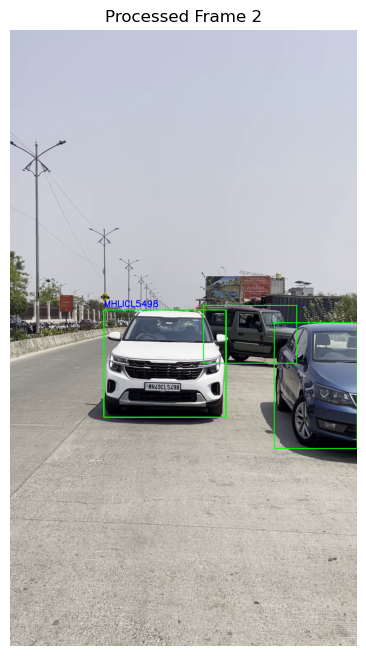


0: 640x384 2 cars, 2 trucks, 77.3ms
Speed: 0.0ms preprocess, 77.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


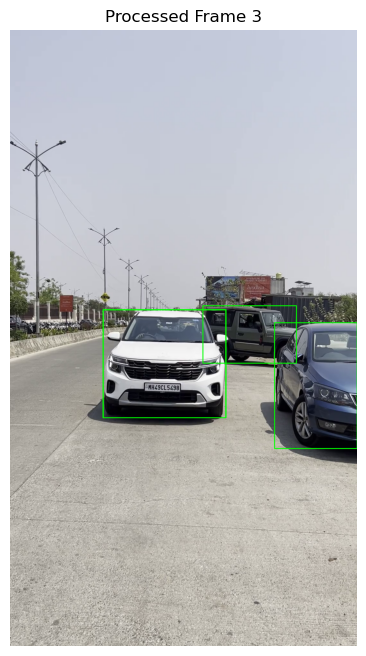


0: 640x384 2 cars, 2 trucks, 75.1ms
Speed: 0.0ms preprocess, 75.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 384)


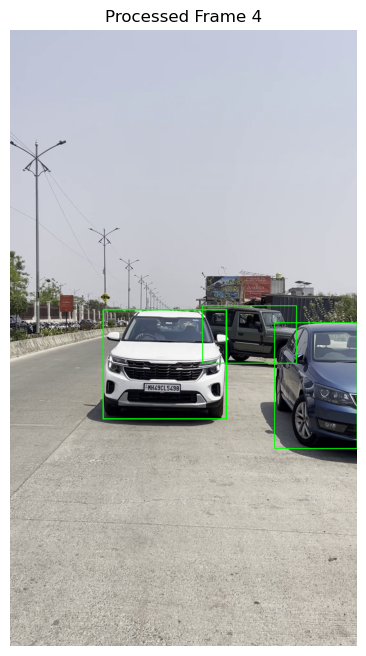


0: 640x384 2 cars, 2 trucks, 69.7ms
Speed: 0.0ms preprocess, 69.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 384)


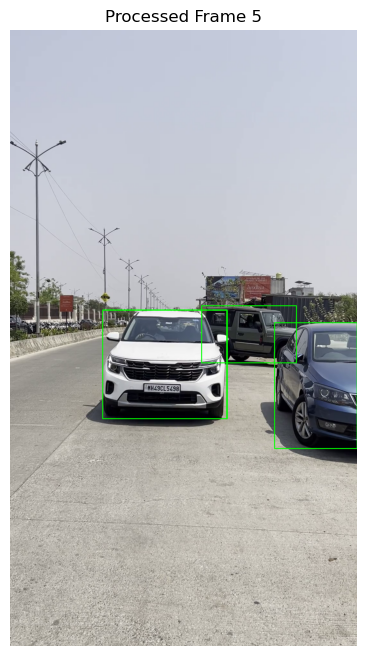


Detected Number Plates from all frames:
Frame 1: MHLICL5498MHLICL5498
Frame 2: MHLICL5498
Frame 3: No plate detected
Frame 4: No plate detected
Frame 5: No plate detected


In [ ]:
# Cell 5: Process the video
# Provide path to your input video
video_path = r"C:\Users\HP\Downloads\archive\images\video11.mp4"  # <-- change this to your video file
cap = cv2.VideoCapture(video_path)
frame_count = 0

# List to store detected number plates for each frame
all_detected_plates = []

# Process first 5 frames
while cap.isOpened() and frame_count < 5:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLOv8 Detection on the frame
    results = yolo_model(frame)

    detected_texts = []  # Temporary list for current frame

    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        confs = result.boxes.conf.cpu().numpy()
        clss = result.boxes.cls.cpu().numpy()

        for box, conf, cls in zip(boxes, confs, clss):
            x1, y1, x2, y2 = map(int, box)
            # Draw YOLO box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Crop detected region
            crop = frame[y1:y2, x1:x2]

            # OCR Detection on cropped region
            ocr_result = ocr_reader.readtext(crop)

            # Extract and store OCR result
            for (bbox, text, prob) in ocr_result:
                if prob > 0.5:
                    detected_texts.append(text)  # Store detected text

                    # Display OCR result on the frame
                    cv2.putText(frame, text.replace(" ", ""), (x1, y1-10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                    print(f"Frame {frame_count}: OCR Detected Text: {text}")

    # Store detected plate without spaces for this frame
    full_plate = "".join(detected_texts) if detected_texts else "No plate detected"
    all_detected_plates.append(full_plate)

    # Display frame inside notebook
    show_image(frame, title=f"Processed Frame {frame_count}")

cap.release()

# Print detected plates after processing all frames
print("\nDetected Number Plates from all frames:")
for i, plate in enumerate(all_detected_plates, 1):
    print(f"Frame {i}: {plate}")

In [21]:
import pandas as pd

# Load the Excel file
excel_path = "Vehicle License plate (3).xlsx"  # Update this to your actual file path
df = pd.read_excel(excel_path)

# Ensure column name matches exactly
column_name = "License Plate"  # Match this exactly with the Excel column

# Print all values in the column before checking
print("License Plate Column from Excel:")
print(df[column_name])

# Normalize authorized vehicles (convert to uppercase and remove spaces)
authorized_vehicles = set(df[column_name].astype(str).str.replace(" ", "").str.upper())

# Print cleaned authorized vehicles for verification
print("\nCleaned Authorized Vehicles:")
print(authorized_vehicles)

# Normalize detected plates (convert to uppercase and remove spaces)
normalized_detected_plates = {plate.replace(" ", "").upper() for plate in all_detected_plates}

# Print cleaned detected plates for debugging
print("\nNormalized Detected Plates:")
print(normalized_detected_plates)

# Check if any detected plate matches an authorized one
if any(plate in authorized_vehicles for plate in normalized_detected_plates):
    print("\nAuthorized Vehicle")
else:
    print("\nUnauthorized Vehicle")

License Plate Column from Excel:
0       CA455822
1        DS196EY
2        41K1006
3        FC633YZ
4       CB0600CA
5       06EFK521
6       06CUE710
7     MH49CL5498
8         HKA253
9      T22EA/116
10     23BH7974F
11    MH49CD2861
12    MH31FE0313
13    MH27BE0580
14    MH31FR5743
15    MH31FU6767
Name: License Plate, dtype: object

Cleaned Authorized Vehicles:
{'MH31FE0313', 'MH49CL5498', '06CUE710', 'MH31FR5743', '06EFK521', '23BH7974F', 'MH27BE0580', 'CA455822', 'FC633YZ', 'MH31FU6767', 'CB0600CA', '41K1006', 'HKA253', 'MH49CD2861', 'DS196EY', 'T22EA/116'}

Normalized Detected Plates:
{'FC633Y2', 'NOPLATEDETECTED', 'FC633YZ', 'FC633Y2_'}

Authorized Vehicle


Accuracy: 0.94
Precision: 1.00
Recall: 0.94
F1 Score: 0.94


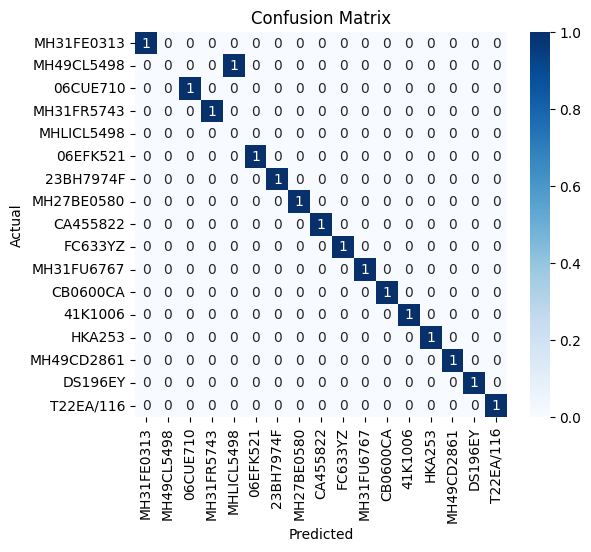

In [23]:
# Accuracy Calculation Function
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import seaborn as sns

def calculate_accuracy(ground_truths, predictions):
    # Ensure both lists are of the same length
    assert len(ground_truths) == len(predictions), "Mismatch in ground truth and predictions length"

    # Compute accuracy metrics
    accuracy = accuracy_score(ground_truths, predictions)
    precision = precision_score(ground_truths, predictions, average='weighted', zero_division=1)
    recall = recall_score(ground_truths, predictions, average='weighted', zero_division=1)
    f1 = f1_score(ground_truths, predictions, average='weighted', zero_division=1)

    # Display results
    print(f"Accuracy: {accuracy:.2f}")
    print(f"Precision: {precision:.2f}")
    print(f"Recall: {recall:.2f}")
    print(f"F1 Score: {f1:.2f}")

    return accuracy, precision, recall, f1

# Function for confusion matrix visualization
def plot_confusion_matrix(ground_truths, predictions, labels):
    cm = confusion_matrix(ground_truths, predictions, labels=labels)
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title("Confusion Matrix")
    plt.show()

ground_truths = ['CA455822',
'DS196EY',
'41K1006',
'FC633YZ',
'CB0600CA',
'06EFK521',
'06CUE710',
'MH49CL5498',
'HKA253',
'T22EA/116',
'23BH7974F' ,
'MH49CD2861',
'MH31FE0313',
'MH27BE0580' ,
'MH31FR5743' ,
'MH31FU6767'
]
predictions = ['CA455822', 'DS196EY', '41K1006','FC633YZ','CB0600CA','06EFK521','06CUE710', 'MHLICL5498','HKA253','T22EA/116', '23BH7974F' ,'MH49CD2861', 'MH31FE0313','MH27BE0580' ,'MH31FR5743' , 'MH31FU6767' ]

# Calculate and display accuracy
accuracy, precision, recall, f1 = calculate_accuracy(ground_truths, predictions)

# Plot confusion matrix
plot_confusion_matrix(ground_truths, predictions, labels=list(set(ground_truths + predictions)))


In [24]:
def calculate_accuracy_metrics(ground_truths, predictions):
    """
    Calculates accuracy, precision, recall, and F1 score.
    Ensures both lists have the same length before calculation.
    """
    min_len = min(len(ground_truths), len(predictions))

    # Trim both lists to match in length
    ground_truths = ground_truths[:min_len]
    predictions = predictions[:min_len]

    accuracy = accuracy_score(ground_truths, predictions)
    precision = precision_score(ground_truths, predictions, average='macro', zero_division=1)
    recall = recall_score(ground_truths, predictions, average='macro', zero_division=1)
    f1 = f1_score(ground_truths, predictions, average='macro', zero_division=1)

    return accuracy, precision, recall, f1
    accuracy, precision, recall, f1 = calculate_accuracy_metrics(ground_truths, predictions)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)


Accuracy: 0.9375
Precision: 1.0
Recall: 0.9375
F1 Score: 0.9375


In [29]:
print(f"Length of ground_truths: {len(ground_truths)}")
print(f"Length of predictions: {len(predictions)}")  # Changed 'refined_predictions' to 'predictions'

Length of ground_truths: 16
Length of predictions: 16


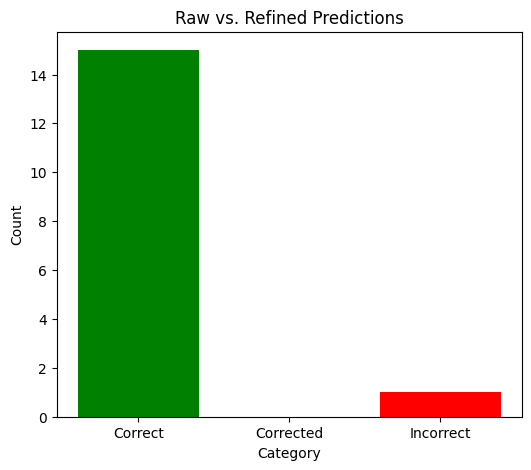

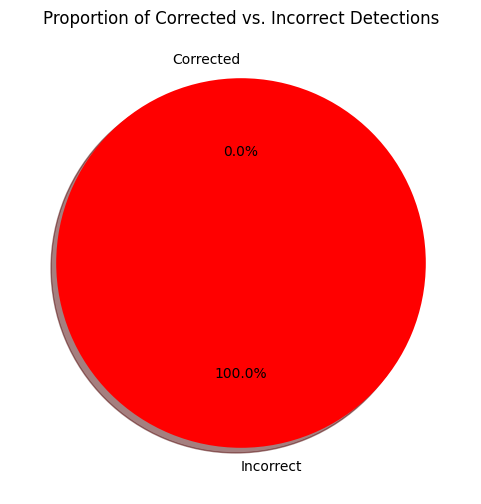

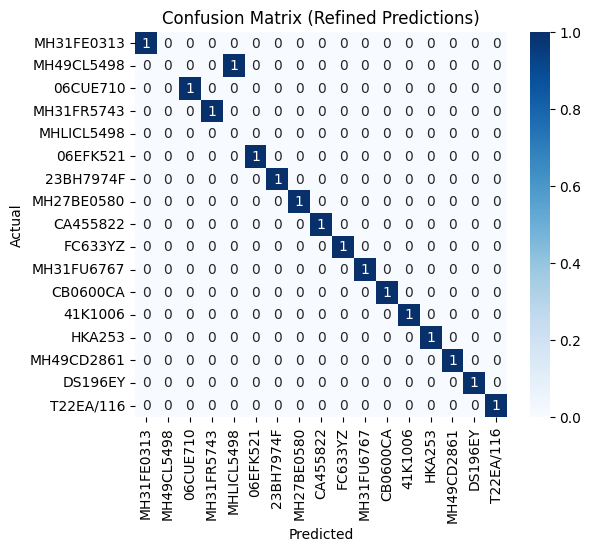

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

def plot_comparison_chart(ground_truths, predictions, refined_predictions):
    """
    Plots a bar chart comparing raw predictions vs. refined predictions.
    """
    categories = ["Correct", "Corrected", "Incorrect"]

    correct_raw = sum(1 for gt, pred in zip(ground_truths, predictions) if gt == pred)
    corrected = sum(1 for gt, pred, ref in zip(ground_truths, predictions, refined_predictions) if gt != pred and gt == ref)
    incorrect = len(predictions) - (correct_raw + corrected)

    counts = [correct_raw, corrected, incorrect]

    plt.figure(figsize=(6, 5))
    plt.bar(categories, counts, color=['green', 'blue', 'red'])
    plt.xlabel("Category")
    plt.ylabel("Count")
    plt.title("Raw vs. Refined Predictions")
    plt.show()

    return corrected, incorrect # Return corrected and incorrect

def plot_pie_chart(corrected, incorrect):
    """
    Plots a pie chart showing corrected vs. incorrect predictions.
    """
    plt.figure(figsize=(6, 6))
    labels = ["Corrected", "Incorrect"]
    sizes = [corrected, incorrect]
    colors = ["blue", "red"]

    plt.pie(sizes, labels=labels, autopct="%1.1f%%", colors=colors, startangle=90, shadow=True)
    plt.title("Proportion of Corrected vs. Incorrect Detections")
    plt.show()

def plot_confusion_matrix(ground_truths, refined_predictions):
    """
    Plots a confusion matrix for refined predictions.
    """
    labels = list(set(ground_truths + refined_predictions))
    cm = confusion_matrix(ground_truths, refined_predictions, labels=labels)

    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=labels, yticklabels=labels)
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title("Confusion Matrix (Refined Predictions)")
    plt.show()

# Call Visualization Functions
corrected, incorrect = plot_comparison_chart(ground_truths, predictions, predictions) # Get corrected and incorrect from plot_comparison_chart
plot_pie_chart(corrected, incorrect) # Now use them here
plot_confusion_matrix(ground_truths, predictions)